# CEIA - Visión por computadora 2

Integrantes del equipo:

* a1604 | Federico Arias Suárez | f_ariassuarez@hotmail.com
* a1618 | Myrna Lorena,Degano | myrna.l.degano@gmail.com
* a1620 | Gustavo Julián Rivas | gus.j.rivas@gmail.com


## Conjunto de datos

### Descripción

https://universe.roboflow.com/myworkspace-iraqv/wildfire_full  
<br>
* <u>Tipo de problema a resolver</u>: Detección de objetos.  
<br>
* <u>Objetivo</u>: Detectar focos de incendio.  
<br>
* <u>Motivación</u>: La Amazonía se está quemando a un ritmo alarmante, afectando el clima, la biodiversidad y el calentamiento global.
Detectar incendios de manera temprana podría marcar la diferencia para evitar daños mayores.

* <u>Créditos</u>:  

 - **title**: Wildfire_Full Dataset
 - **type**: Open Source Dataset
 - **author**: MyWorkspace
 - **URL**: https://universe.roboflow.com/myworkspace-iraqv/wildfire_full
 - **published**: Roboflow Universe
 - **publisher**: Roboflow
 - **year**: 2024
 - **month**: oct

# VGG16

En este notebook vamos a probar un modelo VGG16 para la deteccion del fuego y del humo.

In [ ]:
#Cargamos los datos

! pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="tvpbe4I4XLcB14dkNovn")
project = rf.workspace("myworkspace-iraqv").project("wildfire_full")
version = project.version(1)
dataset = version.download("coco")

'\n! pip install roboflow\n\nfrom roboflow import Roboflow\nrf = Roboflow(api_key="tvpbe4I4XLcB14dkNovn")\nproject = rf.workspace("myworkspace-iraqv").project("wildfire_full")\nversion = project.version(1)\ndataset = version.download("coco")\n'

In [ ]:
! pip install pycocotools

In [1]:
import os
import numpy as np
import cv2
import torch
from torchvision.datasets import CocoDetection
import albumentations as A
from albumentations.pytorch import ToTensorV2

class CustomCocoDataset(CocoDetection):
    def __init__(self, root, annFile, transform=None):
        super().__init__(root, annFile)
        self.transform = transform
        # Guardar rutas completas de imágenes
        self.imgs = [os.path.join(root, img['file_name']) for img in self.coco.loadImgs(self.ids)]

    def __getitem__(self, idx):
        # Leer la imagen
        img_path = self.imgs[idx]
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir de BGR a RGB
        height, width = img.shape[:2]
               
        # Obtener anotaciones (bounding boxes y labels)
        target = self.coco.loadAnns(self.coco.getAnnIds(imgIds=self.ids[idx]))
        bboxes = []
        category_ids = []
        for ann in target:
            bbox = ann['bbox']  # Formato COCO: [x_min, y_min, width, height]
            # Convertir a Pascal VOC: [x_min, y_min, x_max, y_max]
            bbox[2] += bbox[0]
            bbox[3] += bbox[1]
            bboxes.append(bbox)
            category_ids.append(ann['category_id'] - 1)  # Reindexar las etiquetas porque vienen de 1 a 2, en vez de 0 a 1
        
        # Validar que los bounding boxes están dentro de los límites de la imagen
        bboxes = [
            [
                max(0, min(x_min, width)),
                max(0, min(y_min, height)),
                max(0, min(x_max, width)),
                max(0, min(y_max, height))
            ]
            for x_min, y_min, x_max, y_max in bboxes
        ]
                
        # Aplicar transformaciones (si se especificaron)
        if self.transform:
            # Convertir la imagen a un array de numpy (requiere albumentations)
            img = np.array(img)
            
            #tipo float32
            img = img.astype(np.float32)

            transformed = self.transform(image=img, bboxes=bboxes, category_ids=category_ids)
            img = transformed['image']
            bboxes = transformed['bboxes']
            category_ids = transformed['category_ids']
        
        # Convertir a tensores
        target = {
            'boxes': torch.tensor(bboxes, dtype=torch.float32),
            'labels': torch.tensor(category_ids, dtype=torch.int64)
        }
        
        return img, target


c:\Users\Federico\torch_env\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Data Augmentation
Vamos a generar un dataset augmentado y mantener el otro sin augmentacion

In [ ]:
transform_aug = A.Compose([
    A.Resize(500, 500),  # Redimensionar imágenes
    A.RandomBrightnessContrast(brightness_limit=0.15, contrast_limit=0.15, p=0.8),  # Cambios en brillo y contraste
    A.MotionBlur(blur_limit=5, p=0.5),  # Simula movimiento
    A.GaussianBlur(blur_limit=(3, 7), p=0.5),  # Desenfoque gaussiano
    A.RandomScale(scale_limit=0.2, p=0.5),  # Escalado aleatorio
    A.RandomSunFlare(flare_roi=(0, 0, 1, 0.5), angle_lower=0.1, src_radius=20, p=0.3),  # Destellos solares
        A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225], max_pixel_value=255.0),   # Normalización de ImageNet
    ToTensorV2()  # Convertir a tensores para PyTorch
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['category_ids']))

Vamos a justificar cada tratamiento a las imagenes:
- Resize: Requerimiento del modelo.
- RandomBrightnessContrast: Las condiciones de iluminación pueden variar ampliamente en un bosque, debido a la hora del día, el clima y la presencia de nubes. Esta transformación simula esas variaciones.
- MotionBlur: Suponiendo una condicion en la que drones, o helicopteros merodean una zona, las imágenes pueden capturarse con movimiento debido a la vibración.
- GaussianBlur: El desenfoque gaussiano ayuda a suavizar la imagen, reduciendo el ruido y las texturas finas que podrían confundir al modelo
- RandomScale: Los incendios forestales pueden variar significativamente en tamaño y distancia de la cámara. Escalar las imágenes ayuda al modelo a detectar incendios de diferentes tamaños.
- RandomSunFlare: Los destellos solares pueden aparecer en imágenes tomadas al aire libre, interfiriendo con la visibilidad de incendios y humo.
- Normalize: Solicitud del modelo.

In [3]:
# Dataset original (con transformaciones mínimas)
transform_original = A.Compose([
    A.Resize(500, 500),  # Redimensionar imágenes
    A.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225], max_pixel_value=255.0),   # Normalización de ImageNet
    ToTensorV2()  # Convertir a tensores para PyTorch
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['category_ids']))


In [4]:
base_path = r"C:\Users\Federico\CEIA_Pytorch\CV_II\TP_WildFires\Wildfire_Full-1"
train_path = os.path.join(base_path, "train")
valid_path = os.path.join(base_path, "valid")
test_path = os.path.join(base_path, "test")

train_dataset = CustomCocoDataset(
    root=train_path,
    annFile=os.path.join(train_path, "_annotations_new.coco.json"),
    transform=transform_original
)

train_dataset_augment = CustomCocoDataset(
    root=train_path,
    annFile=os.path.join(train_path, "_annotations_new.coco.json"),
    transform=transform_aug
)

valid_dataset = CustomCocoDataset(
    root=valid_path,
    annFile=os.path.join(valid_path, "_annotations.coco.json"),
    transform=transform_original
)

test_dataset = CustomCocoDataset(
    root=test_path,
    annFile=os.path.join(test_path, "_annotations.coco.json"),
    transform=transform_original
)

loading annotations into memory...
Done (t=0.16s)
creating index...
index created!
loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [ ]:
#imagen -> train_dataset[0][0]
#Boxes -> train_dataset[0][1]['boxes']
#labels -> train_dataset[0][1]['labels']

tensor([2, 2, 2, 2, 1, 1])

In [94]:
#Combinamos los dataset de entrenamiento:
from torch.utils.data import ConcatDataset, DataLoader

# Combinar datasets original y aumentado
combined_dataset = ConcatDataset([train_dataset, train_dataset_augment])

# Crear DataLoader
train_loader = DataLoader(
    combined_dataset, #combined_dataset
    batch_size=30,  # Tamaño del lote
    shuffle=True,  # Mezclar los datos
    num_workers=0,  # Número de procesos para cargar datos
    collate_fn=(lambda x: tuple(zip(*x)))  # Manejo de lotes con diferentes tamaños
)

valid_loader = DataLoader(
    valid_dataset,
    batch_size=24,
    shuffle=False,
    num_workers=0,
    collate_fn=(lambda x: tuple(zip(*x))  # Usar función personalizada
))

test_loader = DataLoader(
    test_dataset,
    batch_size=24,
    shuffle=False,
    num_workers=0,
    collate_fn=(lambda x: tuple(zip(*x))  # Usar función personalizada
))

In [6]:
#Hay una imagen sin bb ni labels, la vamos a borrar:

corrupted_img = '26131736898_9e6a8cd68f_o_jpg.rf.0afe7aa803afe0a1f051b68d2c4b8e17.jpg'
corrupted_path = os.path.join(train_path, corrupted_img)

# Eliminar el archivo
try:
    os.remove(corrupted_path)
    print(f"El archivo {corrupted_path} ha sido eliminado.")
except FileNotFoundError:
    print(f"El archivo {corrupted_path} no existe.")
except Exception as e:
    print(f"Ocurrió un error al intentar eliminar el archivo: {e}")


#Ahora debemos eliminarla del archivo json:
import json

# Ruta al archivo COCO JSON
json_path = r"C:\Users\Federico\CEIA_Pytorch\CV_II\TP_WildFires\Wildfire_Full-1\train\_annotations.coco.json"

# Cargar el archivo JSON
with open(json_path, "r") as file:
    coco_data = json.load(file)

# ID de la imagen a eliminar
image_id_to_remove = 481

# Filtrar las imágenes para excluir la que tiene el ID específico
coco_data["images"] = [img for img in coco_data["images"] if img["id"] != image_id_to_remove]

# Filtrar las anotaciones para excluir las relacionadas con la imagen eliminada
coco_data["annotations"] = [ann for ann in coco_data["annotations"] if ann["image_id"] != image_id_to_remove]

# Guardar los cambios en un nuevo archivo
output_path = r"C:\Users\Federico\CEIA_Pytorch\CV_II\TP_WildFires\Wildfire_Full-1\train\_annotations_new.coco.json"
with open(output_path, "w") as file:
    json.dump(coco_data, file, indent=4)


El archivo C:\Users\Federico\CEIA_Pytorch\CV_II\TP_WildFires\Wildfire_Full-1\train\26131736898_9e6a8cd68f_o_jpg.rf.0afe7aa803afe0a1f051b68d2c4b8e17.jpg no existe.


Imagen desnormalizada - min: 0.02626827359199524, max: 0.8745098114013672
Imagen_np - min: 0.02626827359199524, max: 0.8745098114013672
Box 0: [116.40625 261.71875 195.3125  332.03125]
Box 0 ajustada: [116.40625 261.71875 195.3125  332.03125]
Box 1: [180.46875 158.59375 258.20312 324.60938]
Box 1 ajustada: [180.46875 158.59375 258.20312 324.60938]


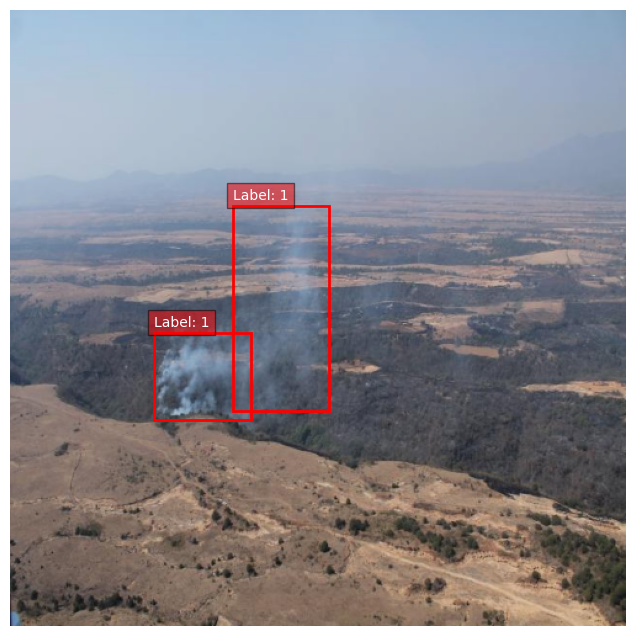

In [6]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
import torch

def desnormalize(image, mean, std):
    """
    Desnormaliza una imagen, porque al hacer la transformacion y querer graficar
    esa imagen, al estar normalizada entre 0 y 1, se ve oscura.

    Args:
        image (torch.Tensor): Imagen normalizada en formato [C, H, W].
        mean (list): Media utilizada para la normalización.
        std (list): Desviación estándar utilizada para la normalización.

    Returns:
        torch.Tensor: Imagen desnormalizada en formato [C, H, W].
    """
    if not isinstance(image, torch.Tensor):
        raise TypeError("La imagen debe ser un tensor de PyTorch.")
    
    desnormalized = image.clone().detach().cpu()
    for t, m, s in zip(desnormalized, mean, std):
        t.mul_(s).add_(m)
    return torch.clamp(desnormalized, 0, 1)

def adjust_box(box, image_width, image_height):
    """
    Ajusta una bounding box para que esté dentro de los límites de la imagen.

    Args:
        box (numpy.ndarray): Bounding box en formato [x_min, y_min, x_max, y_max].
        image_width (int): Ancho de la imagen.
        image_height (int): Alto de la imagen.

    Returns:
        numpy.ndarray: Bounding box ajustada.
    """
    x_min, y_min, x_max, y_max = box
    x_min = max(0, min(x_min, image_width))
    y_min = max(0, min(y_min, image_height))
    x_max = max(0, min(x_max, image_width))
    y_max = max(0, min(y_max, image_height))
    return np.array([x_min, y_min, x_max, y_max])

def plot_image_with_boxes(image, boxes, labels=None, mean=None, std=None):
    """
    Grafica una imagen con bounding boxes superpuestos, desnormalizando primero.

    Args:
        image (torch.Tensor): Imagen en formato [C, H, W], normalizada.
        boxes (torch.Tensor): Bounding boxes en formato [x_min, y_min, x_max, y_max].
        labels (torch.Tensor, opcional): Etiquetas de las bounding boxes.
        mean (list, opcional): Media utilizada para la normalización.
        std (list, opcional): Desviación estándar utilizada para la normalización.
    """
    if mean is None:
        mean = [0.485, 0.456, 0.406]
    if std is None:
        std = [0.229, 0.224, 0.225]
    
    # Desnormalizar la imagen
    image = desnormalize(image, mean, std)
    
    # Imprimir los valores min y max para debugging
    print(f"Imagen desnormalizada - min: {image.min().item()}, max: {image.max().item()}")
    
    # Convertir el tensor a formato NumPy y reordenar los ejes para matplotlib
    image_np = image.numpy().transpose(1, 2, 0)  # [H, W, C]
    
    # Verificar los valores de la imagen
    print(f"Imagen_np - min: {image_np.min()}, max: {image_np.max()}")
    
    # Crear la figura
    fig, ax = plt.subplots(1, figsize=(12, 8))
    ax.imshow(image_np)
    ax.axis('off')
    
    # Dibujar bounding boxes
    for i, box in enumerate(boxes):
        # Convertir la caja a NumPy si es un tensor
        if isinstance(box, torch.Tensor):
            box = box.detach().cpu().numpy()
        print(f"Box {i}: {box}")
        
        # Ajustar la caja si está fuera de los límites
        box = adjust_box(box, image_np.shape[1], image_np.shape[0])
        print(f"Box {i} ajustada: {box}")
        
        x_min, y_min, x_max, y_max = box
        width = x_max - x_min
        height = y_max - y_min
    
        # Dibujar el rectángulo
        rect = patches.Rectangle(
            (x_min, y_min), width, height,
            linewidth=2, edgecolor='red', facecolor='none'
        )
        ax.add_patch(rect)
    
        # Agregar etiqueta, si está disponible
        if labels is not None:
            if isinstance(labels[i], torch.Tensor):
                label = labels[i].item()
            else:
                label = labels[i]
            ax.text(
                x_min, y_min - 5, f"Label: {label}",
                color='white', fontsize=10,
                bbox=dict(facecolor='red', alpha=0.5)
            )
    
    plt.show()

# Obtener un lote del DataLoader
batch = next(iter(train_loader))
images, targets = batch[0], batch[1]

# Seleccionar la imagen y su target
j = 2
if j < len(images):
    img = images[j]
    boxes = targets[j]['boxes']
    labels = targets[j]['labels']

    # Graficar la imagen con bounding boxes
    plot_image_with_boxes(img, boxes, labels)
else:
    print(f"Índice fuera del rango del lote: {j}/{len(images)}")


# Importamos el modelo

In [13]:
from torchvision.models.detection import ssd300_vgg16
from torchvision.models.vgg import VGG16_Weights
import torch

# Inicializar el modelo con pesos preentrenados y 2 clases (1 clase + background)
num_classes = 2  # 2 clase de objetos: fuego | humo. No hay clase para fondo

# Inicializar el modelo SSD con el BACKBONE preentrenado y el número correcto de clases
model_new = ssd300_vgg16(
    weights_backbone=VGG16_Weights.IMAGENET1K_FEATURES,
    num_classes=num_classes
)

#Inspeccionamos la arquitectura del backbone
#print(model_new)

In [14]:
print(model_new)

SSD(
  (backbone): SSDFeatureExtractorVGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=

In [7]:
import torch
# Cargar el modelo completo - cuando ya lo entrenamos antes
model_new = torch.load("modelo_completo.pth")

C:\Users\Federico\AppData\Local\Temp\ipykernel_4932\1061140321.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_new = torch.load("modelo_completo.pth")


**El anchor_generator** (generador de "anchors" o cajas predeterminadas) es una parte esencial de los modelos SSD. 

Genera múltiples "cajas base" con diferentes proporciones y escalas para cada celda del mapa de características.
Estas cajas son comparadas con las bounding boxes reales (durante la pérdida) o ajustadas (durante la inferencia).
No se entrena:

Este módulo no tiene parámetros entrenables, ya que genera cajas fijas. Por lo tanto, no requiere congelación o ajuste.

In [8]:
#Exploramos los nombres de las capas
for name, param in model_new.backbone.named_parameters():  #IMAGENET1K_V1
    print(name, param.requires_grad)   #IMAGENET1K_V1

#for name, param in model_new.named_parameters():
#    print(f"{name}: requires_grad = {param.requires_grad}")


scale_weight True
features.0.weight False
features.0.bias False
features.2.weight False
features.2.bias False
features.5.weight False
features.5.bias False
features.7.weight False
features.7.bias False
features.10.weight False
features.10.bias False
features.12.weight False
features.12.bias False
features.14.weight False
features.14.bias False
features.17.weight False
features.17.bias False
features.19.weight True
features.19.bias True
features.21.weight True
features.21.bias True
extra.0.1.weight True
extra.0.1.bias True
extra.0.3.weight True
extra.0.3.bias True
extra.0.5.weight True
extra.0.5.bias True
extra.0.7.1.weight True
extra.0.7.1.bias True
extra.0.7.3.weight True
extra.0.7.3.bias True
extra.1.0.weight True
extra.1.0.bias True
extra.1.2.weight True
extra.1.2.bias True
extra.2.0.weight True
extra.2.0.bias True
extra.2.2.weight True
extra.2.2.bias True
extra.3.0.weight True
extra.3.0.bias True
extra.3.2.weight True
extra.3.2.bias True
extra.4.0.weight True
extra.4.0.bias True
ex

Vamos a congelar las capas iniciales del backbone:

Las primeras capas (conv1, conv2, conv3) extraen características genéricas útiles para muchas tareas, por lo que es mejor mantener los pesos preentrenados.

La capas más profundas (conv4) y las capas adicionales (extra) contienen características específicas que pueden ajustarse mejor al conjunto de datos.

La cabeza de clasificación (classification_head) y de regresión (regression_head) siempre deben ser entrenadas, ya que son específicas de cada tarea.

In [9]:
# Congelar capas iniciales del backbone
for i, (name, param) in enumerate(model_new.backbone.features.named_parameters()):
    if i <= 15:  # Congela hasta la capa 
        param.requires_grad = False
    else:  # Descongela el resto
        param.requires_grad = True

# Asegurarse de que las capas "extra" están descongeladas
for param in model_new.backbone.extra.parameters():
    param.requires_grad = True

# Asegurarse de que las cabezas están descongeladas
for param in model_new.head.classification_head.parameters():
    param.requires_grad = True

for param in model_new.head.regression_head.parameters():
    param.requires_grad = True

# Verificar qué parámetros serán entrenados
params_to_train = [param for param in model_new.parameters() if param.requires_grad]
print(f"Total parameters to train: {len(params_to_train)}")

Total parameters to train: 55


In [103]:
#Skip if loaded model
import torch.optim as optim
from torch.optim import AdamW

# Configurar optimizador
#optimizer = optim.SGD(model_new.parameters(), lr=0.0009)#, momentum=0.9, weight_decay=0.0005) #lr=0.0009 original
#Al ppio lr= 0.0004
optimizer = AdamW(model_new.parameters(), lr=0.0007, weight_decay=0.0001) #lr=0.0004

In [11]:
# Verificar el dispositivo del modelo
print(next(model_new.parameters()).device)

cuda:0


Primero hay que correr el loss sobre el clasificador para que converja, luego con la suma de las losses.

In [104]:
# Loop de entrenamiento
# Configurar dispositivo
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model_new.to(device)

num_epochs = 5
log_interval = 12  # Imprimir cada 10 batches

for epoch in range(num_epochs):
    model_new.train()
    epoch_loss = 0.0
    epoch_class_loss = 0.0
    epoch_bbox_losses = 0.0

    # Variables para acumular pérdidas en el intervalo de logging
    batch_loss_sum = 0.0
    batch_class_loss_sum = 0.0
    batch_bbox_loss_sum = 0.0

    for batch_idx, (images, targets) in enumerate(train_loader):
        # Mover datos al dispositivo
        images = list(img.to(device) for img in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        # Reiniciar los gradientes
        optimizer.zero_grad()

        # Forward pass
        loss_dict = model_new(images, targets)

        # Sumar todas las pérdidas
        total_loss = sum(loss for loss in loss_dict.values())
        class_loss = loss_dict['classification']
        bbox_loss = loss_dict['bbox_regression']

        # Acumular pérdidas para la época
        epoch_loss += total_loss.item()
        epoch_class_loss += class_loss.item()
        epoch_bbox_losses += bbox_loss.item()

        # Acumular pérdidas para el intervalo de logging
        batch_loss_sum += total_loss.item()
        batch_class_loss_sum += class_loss.item()
        batch_bbox_loss_sum += bbox_loss.item()

        # Backward pass y optimización
        #total_loss.backward()
        bbox_loss.backward()
        #class_loss.backward()

        optimizer.step()

        # Logging cada 'log_interval' batches
        if (batch_idx + 1) % log_interval == 0:
            avg_batch_loss = batch_loss_sum / log_interval
            avg_class_loss = batch_class_loss_sum / log_interval
            avg_bbox_loss = batch_bbox_loss_sum / log_interval

            print(f"Epoch [{epoch+1}/{num_epochs}], Batch [{batch_idx+1}/{len(train_loader)}]:")
            print(f"  --> Avg General Loss: {avg_batch_loss:.4f}")
            print(f"  --> Avg Classification Loss: {avg_class_loss:.4f}")
            print(f"  --> Avg BBox Loss: {avg_bbox_loss:.4f}")

            # Resetear las sumas de pérdidas para el siguiente intervalo
            batch_loss_sum = 0.0
            batch_class_loss_sum = 0.0
            batch_bbox_loss_sum = 0.0

    print(f"\nEpoch [{epoch+1}/{num_epochs}] Summary:")
    print(f"  --> Total Epoch Loss: {epoch_loss:.4f}")
    print(f"  --> Average Classification Loss: {epoch_class_loss:.4f}")
    print(f"  --> Average BBox Loss: {epoch_bbox_losses:.4f}")
    print("********************************************\n")

Epoch [1/5], Batch [12/42]:
  --> Avg General Loss: 3.2481
  --> Avg Classification Loss: 1.5511
  --> Avg BBox Loss: 1.6970
Epoch [1/5], Batch [24/42]:
  --> Avg General Loss: 3.3117
  --> Avg Classification Loss: 1.6603
  --> Avg BBox Loss: 1.6514
Epoch [1/5], Batch [36/42]:
  --> Avg General Loss: 3.2607
  --> Avg Classification Loss: 1.6032
  --> Avg BBox Loss: 1.6575

Epoch [1/5] Summary:
  --> Total Epoch Loss: 137.6409
  --> Average Classification Loss: 67.9725
  --> Average BBox Loss: 69.6684
********************************************

Epoch [2/5], Batch [12/42]:
  --> Avg General Loss: 3.2706
  --> Avg Classification Loss: 1.6336
  --> Avg BBox Loss: 1.6370
Epoch [2/5], Batch [24/42]:
  --> Avg General Loss: 3.2830
  --> Avg Classification Loss: 1.6713
  --> Avg BBox Loss: 1.6118
Epoch [2/5], Batch [36/42]:
  --> Avg General Loss: 3.2498
  --> Avg Classification Loss: 1.5808
  --> Avg BBox Loss: 1.6690

Epoch [2/5] Summary:
  --> Total Epoch Loss: 137.3001
  --> Average Clas

De este entrenamiento, nos fijamos sobre el summary: el Average General Loss (que contiene la loss de classificacion y la loss de los bb)

Luego de entrenar por 60 epocas y variando manualmente el optimizador, vemos que no logra bajar del valor de 65.

Luego se hizo la augmentacion de datos y la loss general no bajo de 138 por 20 epocas.

In [97]:
# Guardar el modelo completo
torch.save(model_new, "modelo_completo.pth")

Ya entrenamos 10 epocas con las losses sumandas
- Ahora vamos a entrenar 10 epocas mas haciendo backpropagation a las loss de las bb
- Posterior 10 epocas con class losses
- Luego se estanca y cambiamos el optimizador
- AdamW(model_new.parameters(), lr=0.0004)
- Luego se probo con Data Augmentada y no bajo la loss general de 80.

In [91]:
import torch
from torchvision.ops import box_iou

def evaluate_model(model, data_loader, device, threshold=0.4):
    """
    Evalúa el modelo en un DataLoader, sin usar NMS, y calcula métricas.

    Args:
        model: Modelo PyTorch entrenado.
        data_loader: DataLoader con imágenes y targets.
        device: CPU o GPU.
        threshold: Umbral para filtrar predicciones por confianza.

    Returns:
        metrics: Diccionario con métricas calculadas.
    """
    model.eval()  # Cambiar el modelo a modo evaluación
    total_targets = 0
    total_predictions = 0
    correct_predictions = 0

    with torch.no_grad():
        for images, targets in data_loader:
            # Mover imágenes al dispositivo
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # Realizar predicciones
            predictions = model(images)

            for i, prediction in enumerate(predictions):
                pred_boxes = prediction['boxes']
                pred_scores = prediction['scores']
                true_boxes = targets[i]['boxes']

                # Filtrar predicciones por confianza
                valid_indices = pred_scores >= threshold
                pred_boxes = pred_boxes[valid_indices]

                # Métrica: IoU (Intersection over Union)
                if len(pred_boxes) > 0 and len(true_boxes) > 0:
                    iou_matrix = box_iou(pred_boxes, true_boxes)
                    correct_predictions += (iou_matrix > 0.6).sum().item()

                # Actualizar conteos
                total_predictions += len(pred_boxes)
                total_targets += len(true_boxes)

    # Calcular métricas
    precision = correct_predictions / total_predictions if total_predictions > 0 else 0
    recall = correct_predictions / total_targets if total_targets > 0 else 0

    metrics = {
        "precision": precision,
        "recall": recall,
        "total_targets": total_targets,
        "total_predictions": total_predictions,
        "correct_predictions": correct_predictions,
    }

    # Imprimir métricas
    print("Validation Metrics:")
    for key, value in metrics.items():
        print(f"{key}: {value:.4f}")

    return metrics


In [105]:
# Evaluar el modelo en el conjunto de validación
device = torch.device('cuda')
model_new.to(device)

# Evaluar el modelo
metrics = evaluate_model(
    model=model_new,
    data_loader=test_loader, #valid_loader
    device=device,
    threshold=0.4
)
print(metrics)

Validation Metrics:
precision: 0.6798
recall: 0.4088
total_targets: 296.0000
total_predictions: 178.0000
correct_predictions: 121.0000
{'precision': 0.6797752808988764, 'recall': 0.40878378378378377, 'total_targets': 296, 'total_predictions': 178, 'correct_predictions': 121}


In [70]:
import torch
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torchvision.transforms import functional as F
import numpy as np

# Definir la función de desnormalización
def denormalize(image, mean, std):
    """
    Desnormaliza una imagen tensorial.

    Args:
        image (Tensor): Imagen normalizada.
        mean (list): Media utilizada para la normalización.
        std (list): Desviación estándar utilizada para la normalización.

    Returns:
        Tensor: Imagen desnormalizada.
    """
    for t, m, s in zip(image, mean, std):
        t.mul_(s).add_(m)
    return image

# Definir la función de graficación
def plot_image_with_boxes(image, boxes, labels, label_names, mean, std, title=None):
    """
    Grafica una imagen con bounding boxes y etiquetas.

    Args:
        image (Tensor): Imagen en formato tensor.
        boxes (Tensor): Bounding boxes en formato [x1, y1, x2, y2].
        labels (Tensor): Etiquetas de las bounding boxes.
        label_names (dict): Diccionario para mapear etiquetas a nombres.
        mean (list): Media utilizada para la normalización.
        std (list): Desviación estándar utilizada para la normalización.
        title (str, optional): Título del gráfico.
    """
    # Desnormalizar la imagen
    image = denormalize(image, mean, std)
    
    # Convertir la imagen a formato PIL y luego a numpy
    image = F.to_pil_image(image)
    image = np.array(image)

    # Crear la figura y el eje
    fig, ax = plt.subplots(1, figsize=(12, 12))
    ax.imshow(image)

    # Iterar sobre las bounding boxes y etiquetas
    for box, label in zip(boxes, labels):
        x1, y1, x2, y2 = box
        width = x2 - x1
        height = y2 - y1

        # Crear un rectángulo
        rect = patches.Rectangle((x1, y1), width, height, linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

        # Añadir la etiqueta
        plt.text(x1, y1 - 10, label_names.get(label.item(), 'N/A'), 
                 fontsize=12, color='red', backgroundcolor='white')

    # Añadir título si se proporciona
    if title:
        plt.title(title, fontsize=16)

    plt.axis('off')
    plt.show()

Debajo veremos que el modelo memoriza a poner los mismos dos bb en las mismas posiciones, lo cual no es correcto.

Se intentó cambiando la learning rate, congelando/descongelando otras capas y ponderando la loss de classificacion - bb, pero no se llegó a mejores resultados.

Como se menciona arriba, la Loss General se estanca en 66.

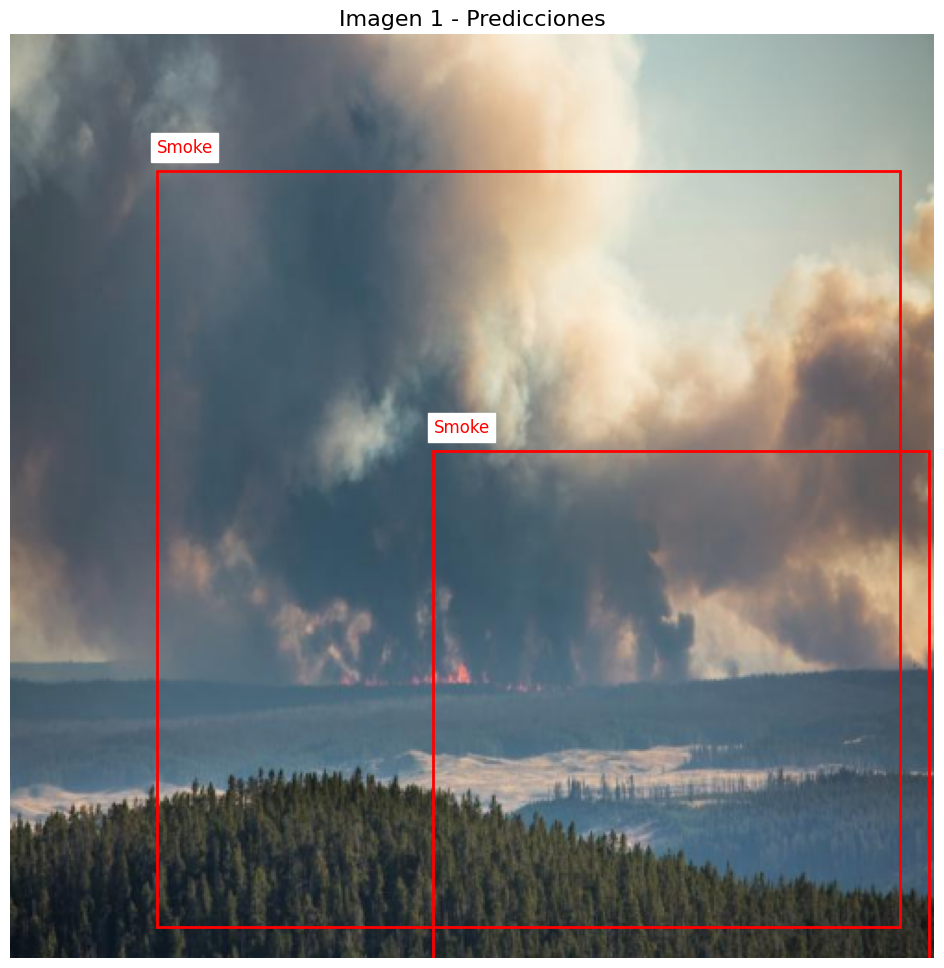

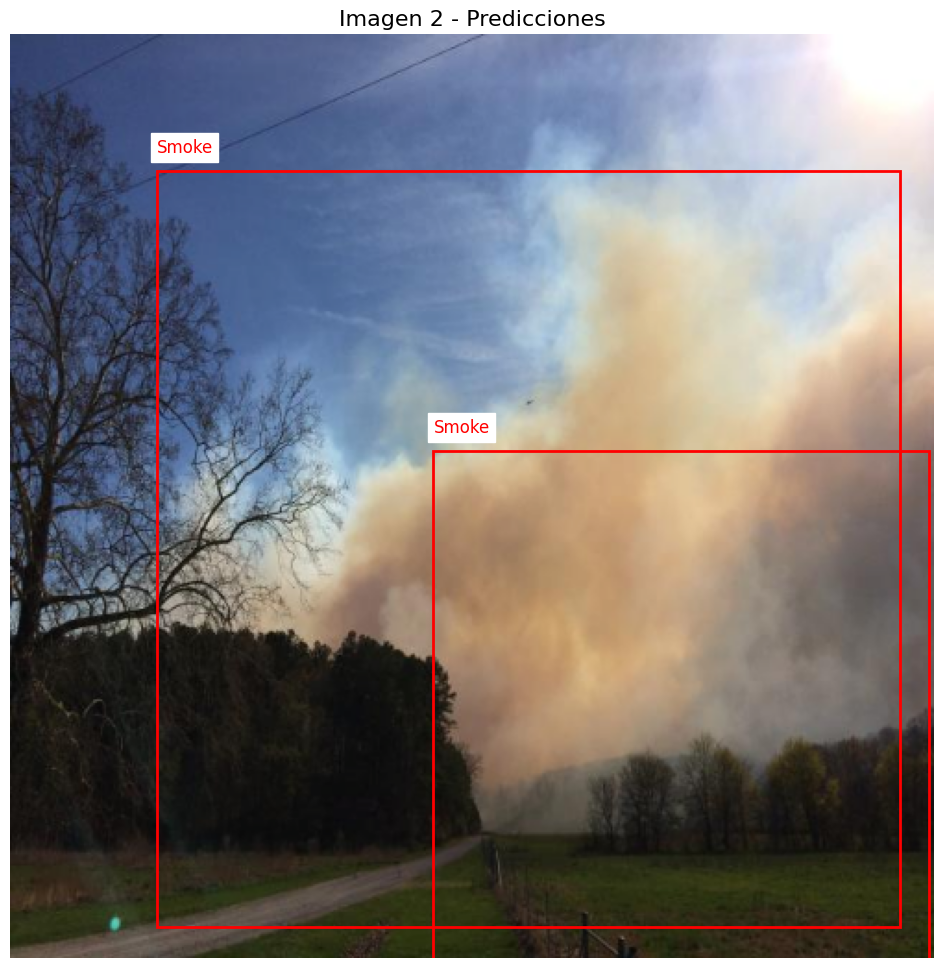

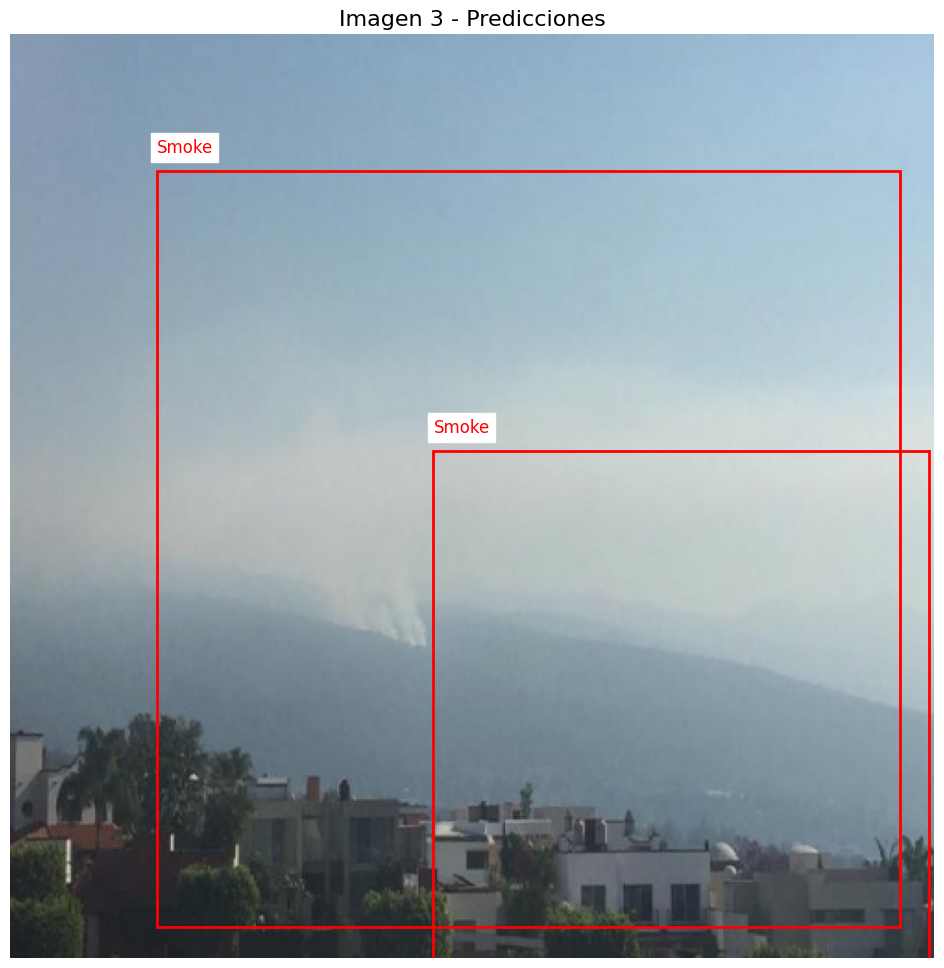

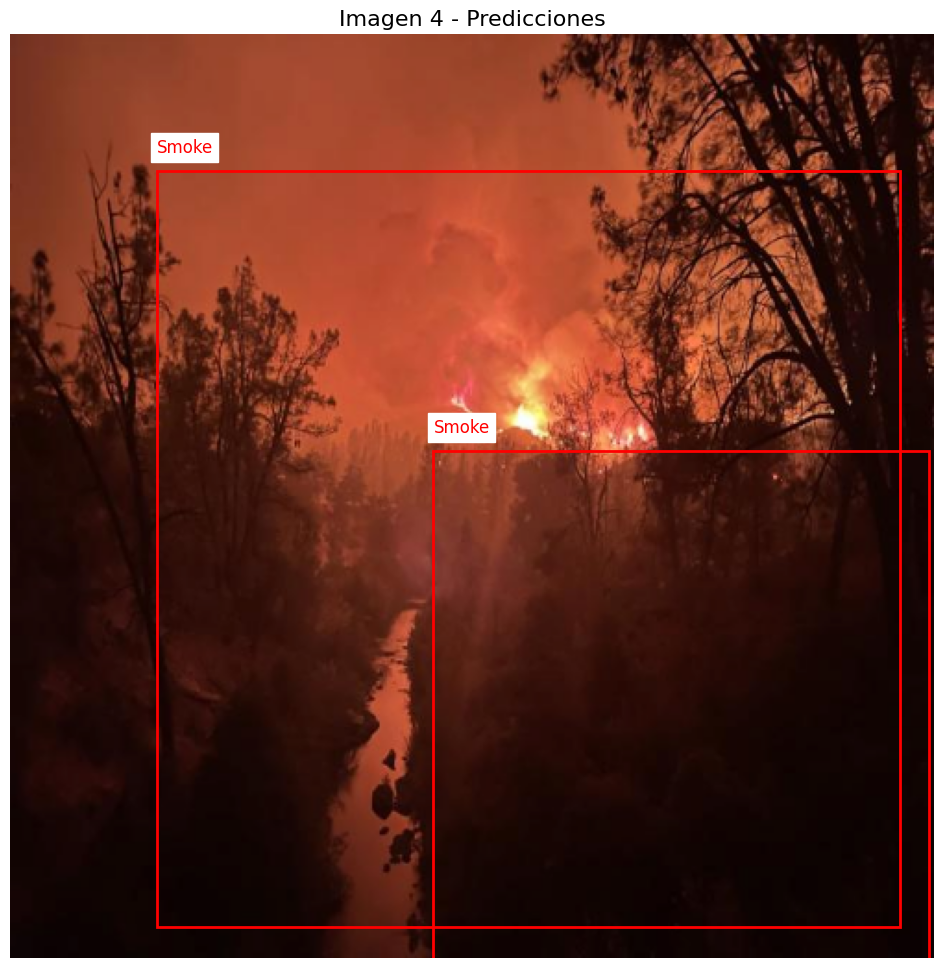

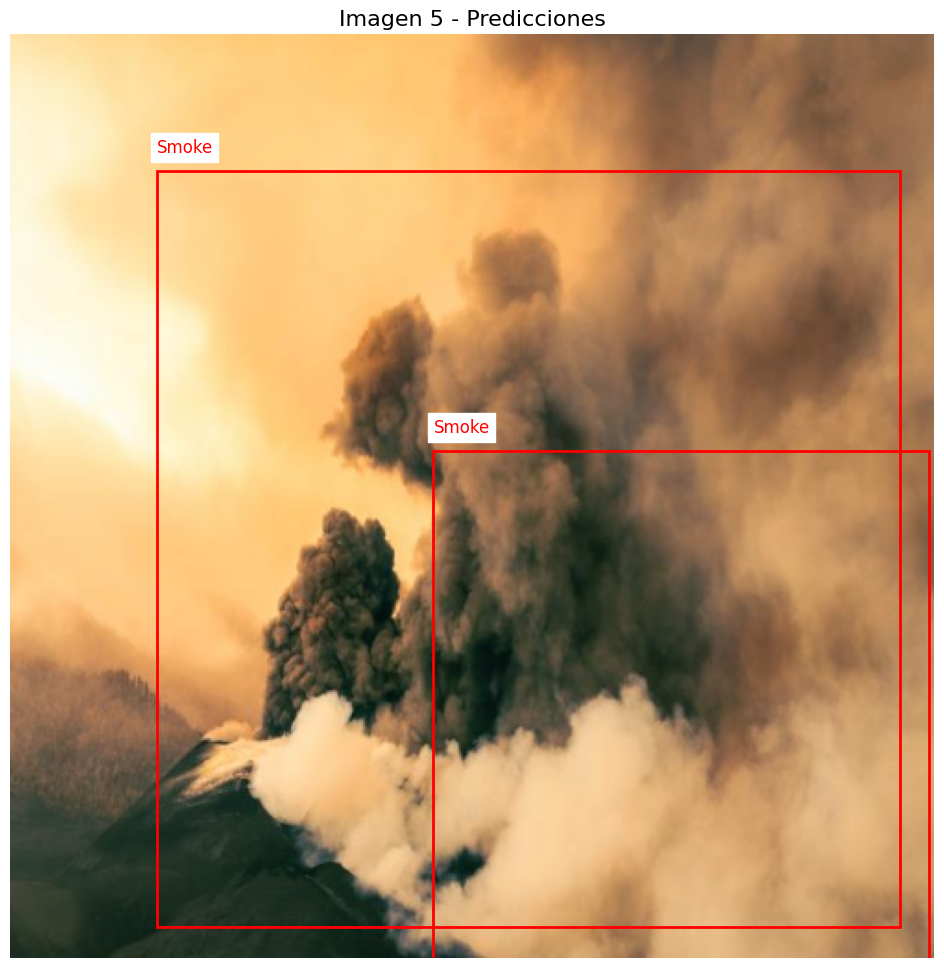

...

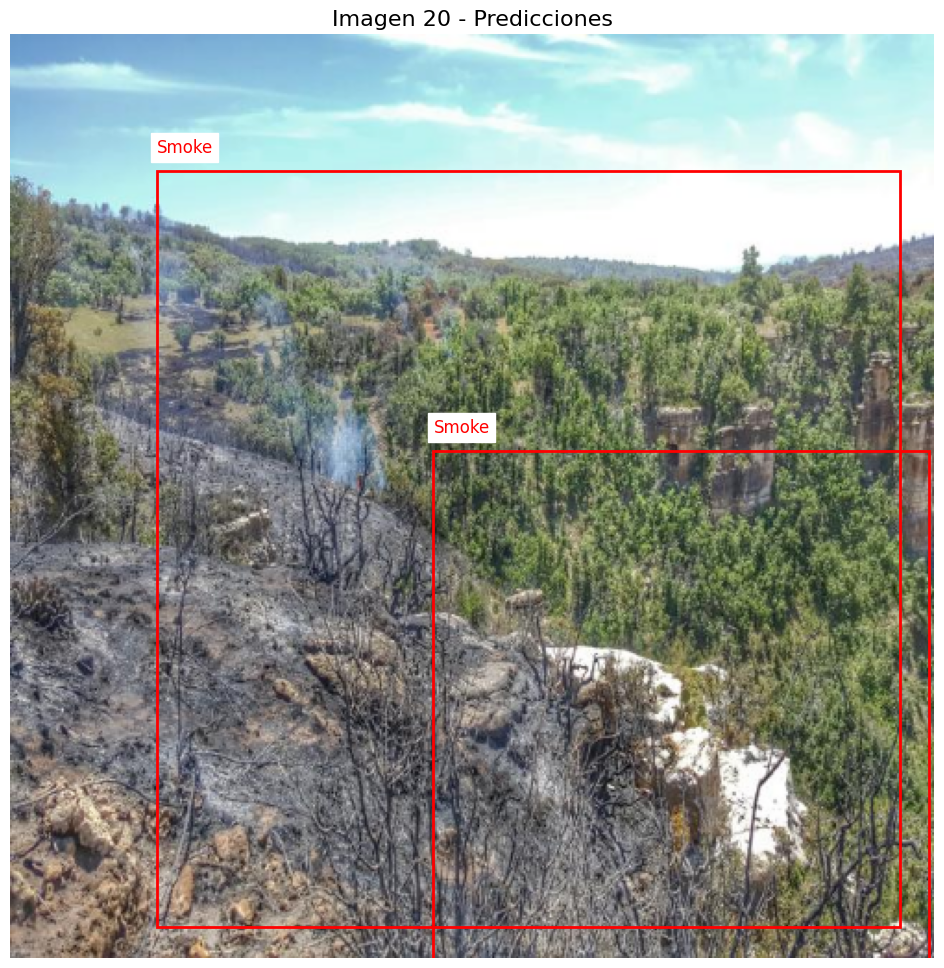

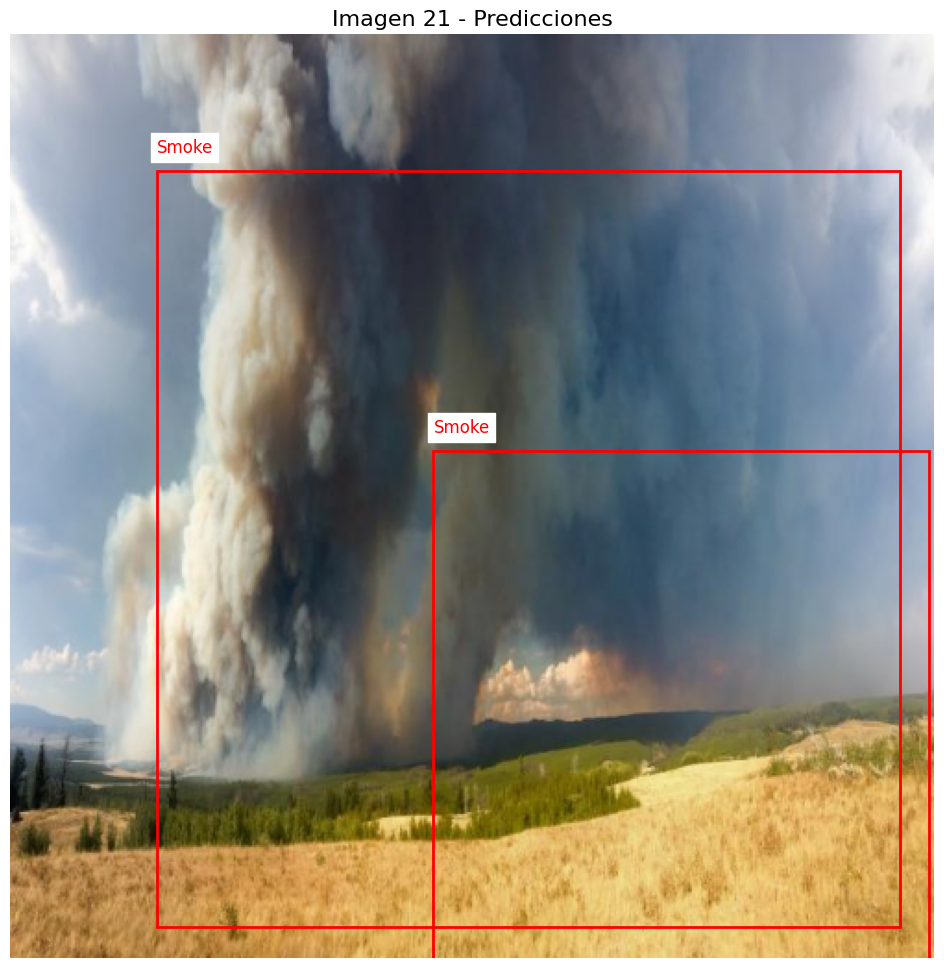

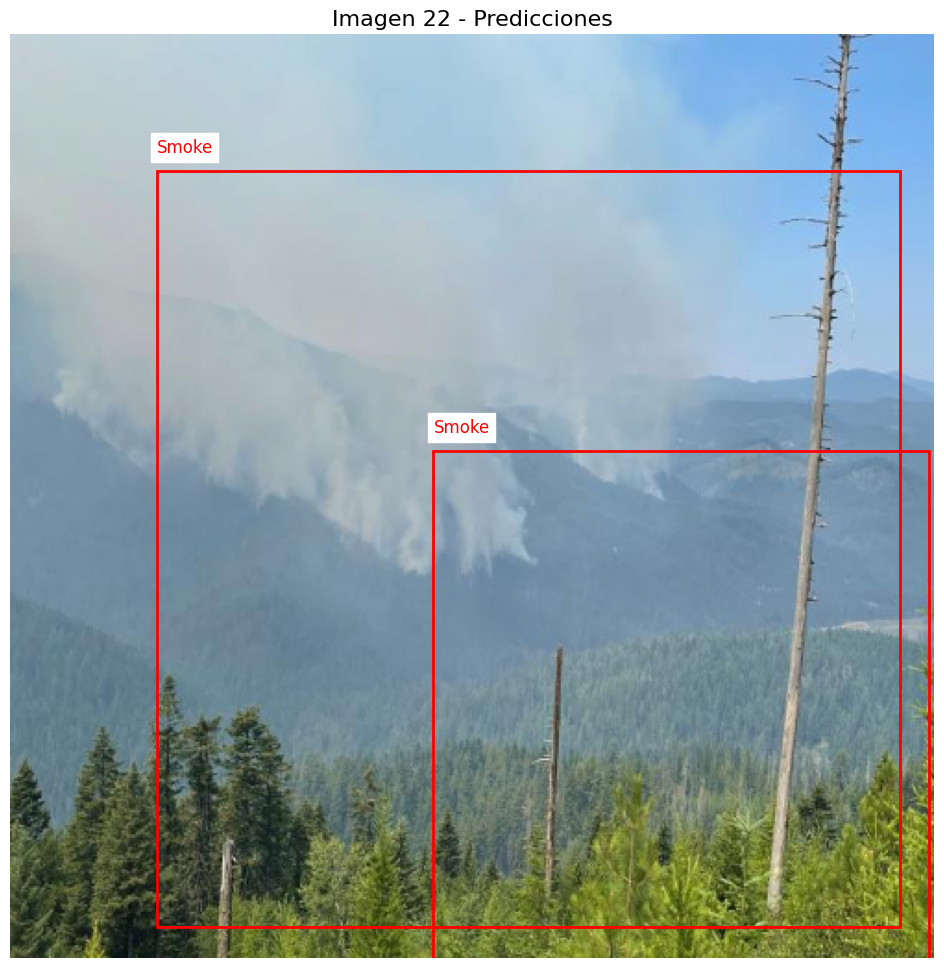

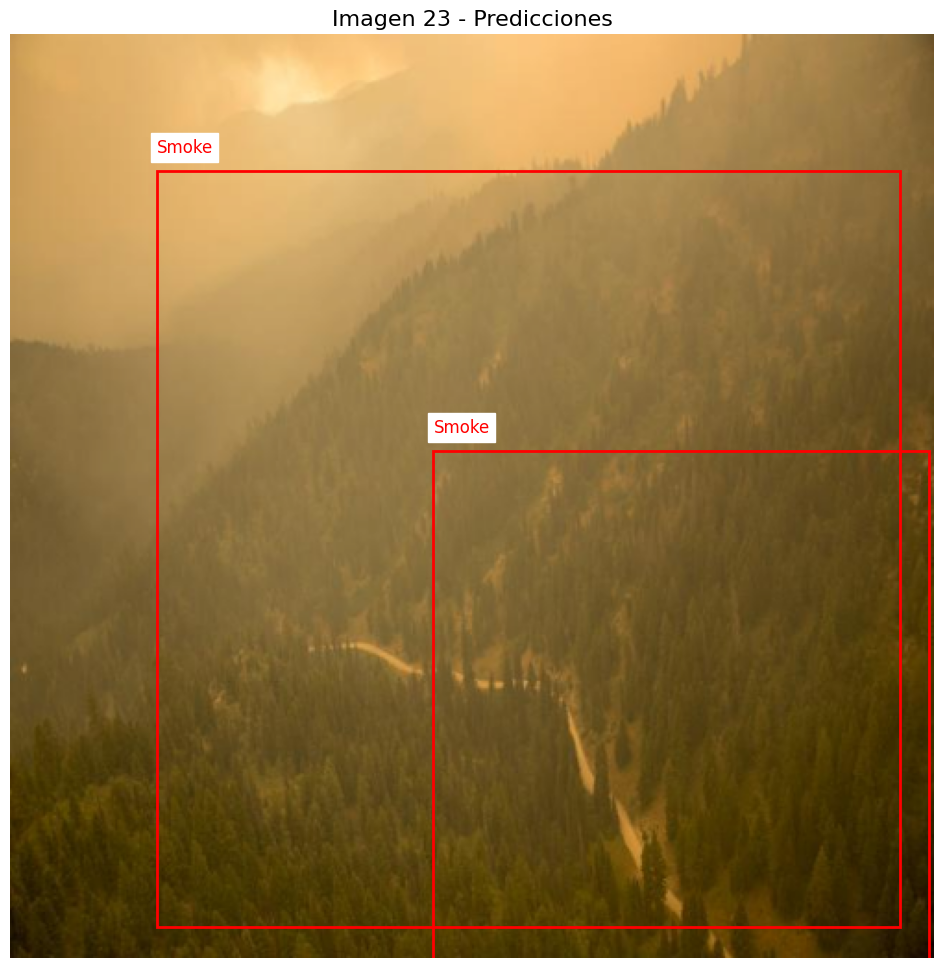

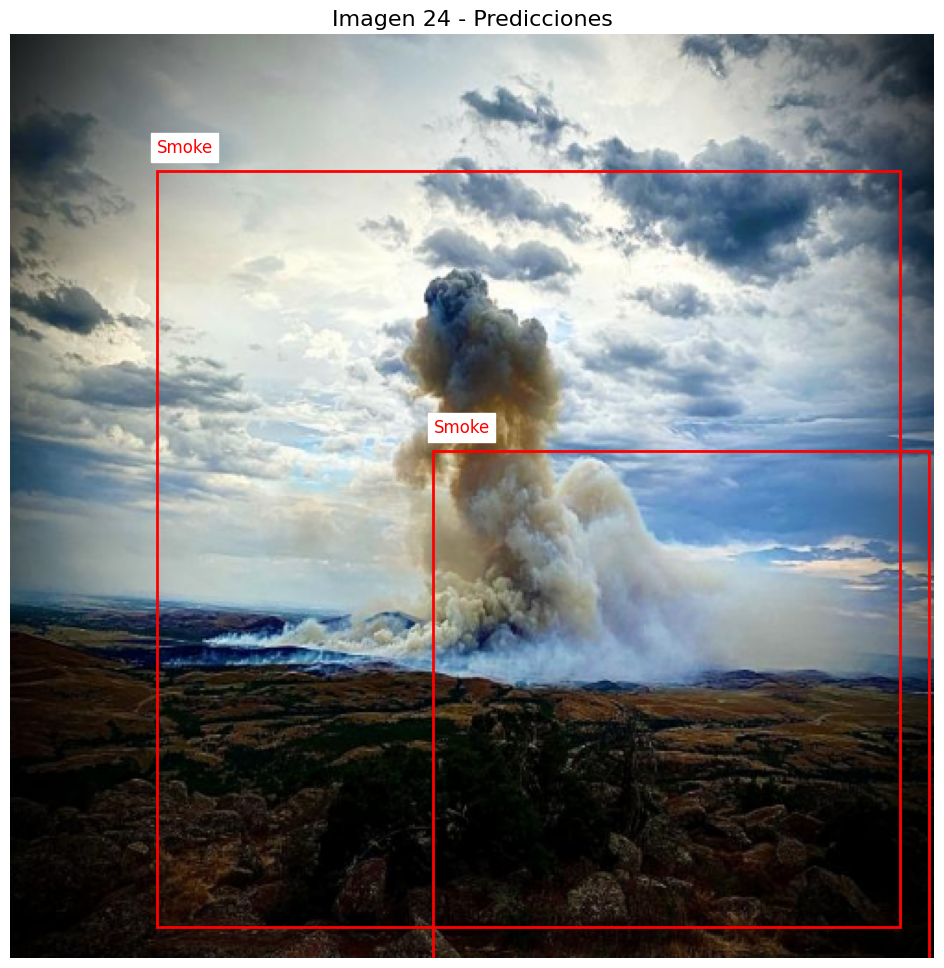

In [106]:
# Ejemplo de mapeo de etiquetas
label_names = {
    1: 'Smoke',   # Supongamos que la clase 1 es 'Incendio'
    2: 'Fire'       # Clase 2 para 'Fondo' u otras clases
    # Añade más clases si las tienes
}

# Definir los parámetros de normalización utilizados en la transformación original
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

# Obtener un lote del DataLoader
images, targets = next(iter(test_loader))
device = torch.device('cpu')  # O 'cuda' si tienes una GPU disponible
model_new.to(device)

# Mover las imágenes al dispositivo
images = [image.to(device) for image in images]

# Establecer el umbral de confianza
threshold = 0.4

# Realizar predicciones
model_new.eval()
with torch.no_grad():
    predictions = model_new(images)

# Iterar sobre cada imagen y sus predicciones
for i in range(len(images)):
    # Obtener las predicciones para la imagen i
    pred_boxes = predictions[i]['boxes']
    pred_scores = predictions[i]['scores']
    pred_labels = predictions[i]['labels']

    # Filtrar las predicciones por el umbral de confianza
    valid_indices = pred_scores >= threshold
    pred_boxes = pred_boxes[valid_indices]
    pred_labels = pred_labels[valid_indices]

    # Obtener la imagen original (desnormalizada)
    image = images[i].cpu()

    # Graficar la imagen con bounding boxes y etiquetas
    plot_image_with_boxes(
        image=image,
        boxes=pred_boxes.cpu(),
        labels=pred_labels.cpu(),
        label_names=label_names,
        mean=mean,
        std=std,
        title=f'Imagen {i+1} - Predicciones'
    )
